# Installing Required Packages

In [1]:
%pip install pmdarima
%pip install arch

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


DEPRECATION: Loading egg at c:\python312\lib\site-packages\vboxapi-1.0-py3.12.egg is deprecated. pip 25.1 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330


Defaulting to user installation because normal site-packages is not writeableNote: you may need to restart the kernel to use updated packages.


DEPRECATION: Loading egg at c:\python312\lib\site-packages\vboxapi-1.0-py3.12.egg is deprecated. pip 25.1 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330


# Importing Packages

In [2]:

# Core Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Statsmodels for Time Series Analysis
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.ar_model import AutoReg
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import statsmodels.api as sm

# Advanced Modeling
from pmdarima import auto_arima
from prophet import Prophet
from arch import arch_model

# Machine Learning
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import IsolationForest

# Deep Learning
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM

# Statistical Analysis
from scipy.stats import zscore
from scipy.stats import boxcox

# Visualization
import plotly.express as px
import plotly.graph_objects as go

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Prepocessing Tech Layoffs Data

In [3]:
data = pd.read_excel("tech_layoffs.xlsx")
data['Date_layoffs'] = pd.to_datetime(data['Date_layoffs'])
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1672 entries, 0 to 1671
Data columns (total 16 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   #                            1672 non-null   int64         
 1   Company                      1672 non-null   object        
 2   Location_HQ                  1672 non-null   object        
 3   Country                      1672 non-null   object        
 4   Continent                    1672 non-null   object        
 5   Laid_Off                     1565 non-null   float64       
 6   Date_layoffs                 1672 non-null   datetime64[ns]
 7   Percentage                   1570 non-null   float64       
 8   Company_Size_before_Layoffs  1511 non-null   float64       
 9   Company_Size_after_layoffs   1536 non-null   float64       
 10  Industry                     1672 non-null   object        
 11  Stage                        1672 non-null 

In [4]:
data.head()

,#,Company,Location_HQ,Country,Continent,Laid_Off,Date_layoffs,Percentage,Company_Size_before_Layoffs,Company_Size_after_layoffs,Industry,Stage,Money_Raised_in_$_mil,Year,lat,lng
0,3,ShareChat,Bengaluru,India,Asia,200.0,2023-12-20,15.0,1333.0,1133.0,Consumer,Series H,$1700,2023,12.97194,77.59369
1,4,InSightec,Haifa,Israel,Asia,100.0,2023-12-19,20.0,500.0,400.0,Healthcare,Unknown,$733,2023,32.81841,34.98850
2,6,Enphase Energy,San Francisco Bay Area,USA,North America,350.0,2023-12-18,10.0,3500.0,3150.0,Energy,Post-IPO,$116,2023,37.54827,-121.98857
3,7,Udaan,Bengaluru,India,Asia,100.0,2023-12-18,10.0,1000.0,900.0,Retail,Unknown,NaN,2023,12.97194,77.59369
4,14,Cruise,San Francisco Bay Area,USA,North America,900.0,2023-12-14,24.0,3750.0,2850.0,Transportation,Acquired,$15000,2023,37.77493,-122.41942


In [5]:
print(data.isna().sum()) #No NA values

#                                0
Company                          0
Location_HQ                      0
Country                          0
Continent                        0
Laid_Off                       107
Date_layoffs                     0
Percentage                     102
Company_Size_before_Layoffs    161
Company_Size_after_layoffs     136
Industry                         0
Stage                            0
Money_Raised_in_$_mil           76
Year                             0
lat                              0
lng                              0
dtype: int64


In [6]:

df = pd.DataFrame(data)

# Convert 'Date_layoffs' to datetime
df['Date_layoffs'] = pd.to_datetime(df['Date_layoffs'])

df = df.dropna(subset=['Laid_Off'])
# Remove dollar sign and convert 'Money_Raised_in_$_mil' to float
df['Money_Raised_in_$_mil'] = df['Money_Raised_in_$_mil'].replace('[\$,]', '', regex=True).astype(float)

# Fill missing 'Money_Raised_in_$_mil' with the median
df['Money_Raised_in_$_mil'] = df['Money_Raised_in_$_mil'].fillna(df['Money_Raised_in_$_mil'].median())

# Fill missing values in 'Company_Size_before_Layoffs' and 'Company_Size_after_layoffs' with median
df['Company_Size_before_Layoffs'] = df['Company_Size_before_Layoffs'].fillna(df['Company_Size_before_Layoffs'].median())
df['Company_Size_after_layoffs'] = df['Company_Size_after_layoffs'].fillna(df['Company_Size_after_layoffs'].median())

# Fill missing values in 'Percentage' with the median
df['Percentage'] = df['Percentage'].fillna(df['Percentage'].median())

# Verify the data after preprocessing
print("Data after preprocessing:")
print(df)

# Check for any remaining missing values
print("\nMissing values after preprocessing:")
print(df.isna().sum())

Data after preprocessing:
         #         Company             Location_HQ Country      Continent  \
0        3       ShareChat               Bengaluru   India           Asia   
1        4       InSightec                   Haifa  Israel           Asia   
2        6  Enphase Energy  San Francisco Bay Area     USA  North America   
3        7           Udaan               Bengaluru   India           Asia   
4       14          Cruise  San Francisco Bay Area     USA  North America   
...    ...             ...                     ...     ...            ...   
1662  3528  Analog Devices  San Francisco Bay Area     USA  North America   
1663  3529       ForgeRock  San Francisco Bay Area     USA  North America   
1664  3530            Flex  San Francisco Bay Area     USA  North America   
1667  3533          TomTom                    Lodz  Poland         Europe   
1668  3534    Chipper Cash  San Francisco Bay Area     USA  North America   

      Laid_Off Date_layoffs  Percentage  Company_

<>:8: SyntaxWarning: invalid escape sequence '\$'
<>:8: SyntaxWarning: invalid escape sequence '\$'
C:\Users\dwark\AppData\Local\Temp\ipykernel_2960\3239306613.py:8: SyntaxWarning: invalid escape sequence '\$'
  df['Money_Raised_in_$_mil'] = df['Money_Raised_in_$_mil'].replace('[\$,]', '', regex=True).astype(float)


In [7]:
duplicates = df.duplicated()

if duplicates.any():
    print("Duplicates exist")
else:
    print("No duplicates")

No duplicates


In [8]:
data = df.sort_values('Date_layoffs')
time_series = data.groupby('Date_layoffs')['Laid_Off'].sum()


In [9]:
df.to_csv('layoffs.csv')

In [10]:
df.isna().sum()

#                              0
Company                        0
Location_HQ                    0
Country                        0
Continent                      0
Laid_Off                       0
Date_layoffs                   0
Percentage                     0
Company_Size_before_Layoffs    0
Company_Size_after_layoffs     0
Industry                       0
Stage                          0
Money_Raised_in_$_mil          0
Year                           0
lat                            0
lng                            0
dtype: int64

In [11]:
data1=pd.read_csv('layoffs.csv')
data1['Date_layoffs'] = pd.to_datetime(data1['Date_layoffs'])
time_series = data1.groupby('Date_layoffs')['Laid_Off'].sum()

# Augmented Dicky Fuller Test


In [12]:
def adf_test(series):
    result = adfuller(series)
    print("ADF Statistic:", result[0])
    print("p-value:", result[1])
    if result[1] <= 0.05:
        print("The time series is stationary.")
    else:
        print("The time series is non-stationary.")

adf_test(time_series)

# Plot the original time series
fig = px.line(time_series, title='Original Time Series of Layoffs', labels={'value': 'Layoffs', 'index': 'Date'})
fig.show()

ADF Statistic: -3.98197005809521
p-value: 0.0015079202867808485
The time series is stationary.


In [13]:
rolling_mean = time_series.rolling(window=30).mean()
fig = px.line(rolling_mean, title="Rolling Mean (30 Days) of Layoffs")
fig.show()

# Detrending and Differencing (doubtful)

In [14]:
# Detrending
detrended_data = data1['Laid_Off'] - data1['Laid_Off'].rolling(window=12).mean()

# Differencing
differenced_data = data1['Laid_Off'].diff().dropna()

# Plot the detrended and differenced data1
fig = go.Figure()
fig.add_trace(go.Scatter(x=detrended_data.index, y=detrended_data, mode='lines', name='Detrended Series'))
fig.add_trace(go.Scatter(x=differenced_data.index, y=differenced_data, mode='lines', name='Differenced Series'))
fig.update_layout(title="Detrended and Differenced Data",
                  xaxis_title="Date", yaxis_title="Value")
fig.show()

# ACF and PACF Plots (doubtful)

<Figure size 1200x600 with 0 Axes>

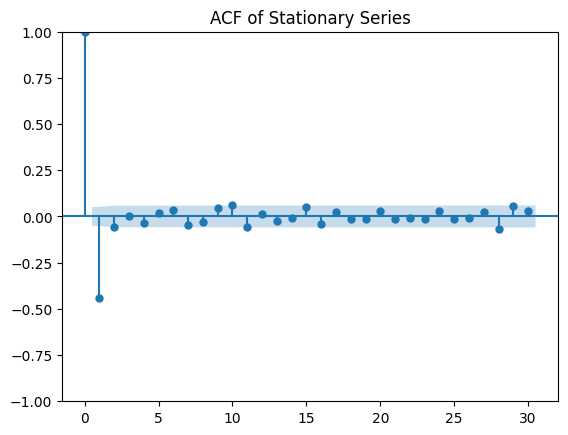

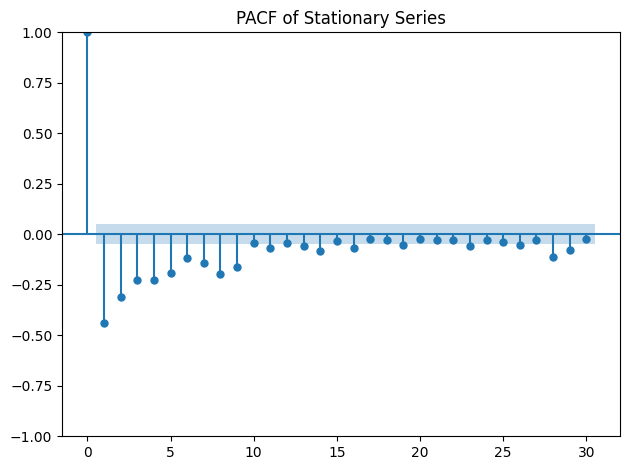

In [15]:
# Plot ACF and PACF for the stationary series
plt.figure(figsize=(12, 6))

# ACF Plot

plot_acf(differenced_data, lags=30)
plt.title('ACF of Stationary Series')

# PACF Plot

plot_pacf(differenced_data, lags=30)
plt.title('PACF of Stationary Series')

plt.tight_layout()
plt.show()


# Check seasonality and volatility

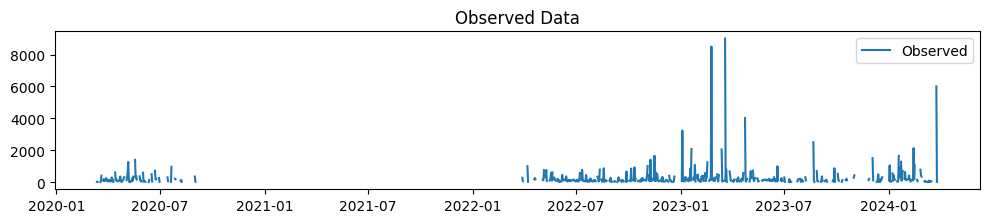

In [16]:
# Ensure datetime index
data1["Date_layoffs"] = pd.to_datetime(data1["Date_layoffs"])
data1.set_index("Date_layoffs", inplace=True)

# Ensure time series data is numeric
time_series = data1["Laid_Off"].dropna()
time_series = time_series[time_series.apply(lambda x: str(x).replace('.', '', 1).isdigit())].astype(float)

# Handle duplicate timestamps by aggregating (e.g., taking the mean for duplicates)
time_series = time_series.groupby(time_series.index).mean()

# Ensure regular frequency
time_series = time_series.asfreq('D')  # Monthly frequency (adjust based on your data)

# --- Seasonality Analysis ---
# STL decomposition
stl = STL(time_series, seasonal=13)  # Seasonal period can be adjusted based on data characteristics
result = stl.fit()

# Plot STL decomposition
plt.figure(figsize=(10, 8))
plt.subplot(4, 1, 1)
plt.plot(result.observed, label="Observed")
plt.title("Observed Data")
plt.legend()

plt.tight_layout()
plt.show()

# --- Volatility Analysis ---
# Calculate rolling statistics
rolling_mean = time_series.rolling(window=12).mean()
rolling_std = time_series.rolling(window=12).std()

# Plot original data with rolling statistics
fig = go.Figure()
fig.add_trace(go.Scatter(x=time_series.index, y=time_series, mode="lines", name="Original Data"))
fig.add_trace(go.Scatter(x=rolling_mean.index, y=rolling_mean, mode="lines", name="Rolling Mean"))
fig.add_trace(go.Scatter(x=rolling_std.index, y=rolling_std, mode="lines", name="Rolling Std Dev"))

fig.update_layout(
    title="Volatility Analysis (Rolling Statistics)",
    xaxis_title="Date",
    yaxis_title="Laid_Off",
    legend_title="Legend",
)
fig.show()


# Fitting Models ARIMA

In [17]:
auto_arima_model = auto_arima(data1['Laid_Off'], seasonal=True, m=12, trace=True, error_action='ignore', suppress_warnings=True)
print(auto_arima_model.summary())

# Step 6: Fit the ARIMA model
order = auto_arima_model.order
seasonal_order = auto_arima_model.seasonal_order
model = sm.tsa.statespace.SARIMAX(data1['Laid_Off'], order=order, seasonal_order=seasonal_order)
results = model.fit(disp=False)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(1,0,1)[12] intercept   : AIC=25687.791, Time=5.54 sec
 ARIMA(0,0,0)(0,0,0)[12] intercept   : AIC=25689.671, Time=0.08 sec
 ARIMA(1,0,0)(1,0,0)[12] intercept   : AIC=25680.518, Time=1.56 sec
 ARIMA(0,0,1)(0,0,1)[12] intercept   : AIC=25680.746, Time=1.44 sec
 ARIMA(0,0,0)(0,0,0)[12]             : AIC=25834.841, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[12] intercept   : AIC=25678.525, Time=0.15 sec
 ARIMA(1,0,0)(0,0,1)[12] intercept   : AIC=25680.517, Time=2.93 sec
 ARIMA(1,0,0)(1,0,1)[12] intercept   : AIC=25682.517, Time=5.08 sec
 ARIMA(2,0,0)(0,0,0)[12] intercept   : AIC=25679.627, Time=0.33 sec
 ARIMA(1,0,1)(0,0,0)[12] intercept   : AIC=25680.264, Time=0.67 sec
 ARIMA(0,0,1)(0,0,0)[12] intercept   : AIC=25678.748, Time=0.33 sec
 ARIMA(2,0,1)(0,0,0)[12] intercept   : AIC=25681.648, Time=1.17 sec
 ARIMA(1,0,0)(0,0,0)[12]             : AIC=25789.294, Time=0.07 sec

Best model:  ARIMA(1,0,0)(0,0,0)[12] intercept
Total fit time: 19.439 se

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it is not monotonic and so will be ignored when e.g. forecasting.

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it is not monotonic and so will be ignored when e.g. forecasting.



In [19]:
# Fit ARIMA model
arima_model = ARIMA(detrended_data, order=(1, 1, 1))
arima_fitted = arima_model.fit()

# Forecast using ARIMA
arima_forecast = arima_fitted.forecast(steps=30)
forecast_index = pd.date_range(start=time_series.index[-1], periods=30, freq='D')

# Plot ARIMA Forecast
fig = px.line(x=forecast_index, y=arima_forecast, title='ARIMA Forecast',
              labels={'x': 'Date', 'y': 'Forecasted Layoffs'})
fig.show()

# Model Summary

In [20]:
def fit_arima_model(data1, order):
    model = ARIMA(data1, order=order)
    model_fitted = model.fit()
    print(model_fitted.summary())
    return model_fitted

# Fit ARIMA model with (1,1,1)
arima_model = fit_arima_model(detrended_data.dropna(), order=(1, 1, 1))

# Print the ARIMA model summary
print("ARIMA Model Summary:")
print(arima_model.summary())


# ---- AR Model ----
def fit_ar_model(data1, lags):
    model_ar = AutoReg(data1, lags=lags)
    model_ar_fitted = model_ar.fit()
    print(model_ar_fitted.summary())
    return model_ar_fitted

# Fit AR Model (1)
ar_model = fit_ar_model(detrended_data.dropna(), lags=1)


# ---- MA Model ----
def fit_ma_model(data1, lags):
    model_ma = ARIMA(data1, order=(0, 0, lags))
    model_ma_fitted = model_ma.fit()
    print(model_ma_fitted.summary())
    return model_ma_fitted

# Fit MA Model (1)
ma_model = fit_ma_model(detrended_data.dropna(), lags=1)


C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.



                               SARIMAX Results                                
Dep. Variable:               Laid_Off   No. Observations:                 1554
Model:                 ARIMA(1, 1, 1)   Log Likelihood              -12659.028
Date:                Wed, 20 Nov 2024   AIC                          25324.055
Time:                        15:51:23   BIC                          25340.099
Sample:                             0   HQIC                         25330.022
                               - 1554                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0558      0.011      4.913      0.000       0.034       0.078
ma.L1         -1.0000      0.006   -168.847      0.000      -1.012      -0.988
sigma2      7.027e+05   8.43e-09   8.33e+13      0.0

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot 

# ARIMA model residuals

In [21]:
# ---- Plotting the Results ----

# Plot ARIMA Residuals
fig_arima_residuals = go.Figure()
fig_arima_residuals.add_trace(go.Scatter(x=arima_model.fittedvalues.index,
                                         y=arima_model.resid,
                                         mode='lines',
                                         name='ARIMA Residuals'))
fig_arima_residuals.update_layout(title="ARIMA Model Residuals",
                                  xaxis_title="Date",
                                  yaxis_title="Residuals")
fig_arima_residuals.show()

# GARCH Model Forecasting

In [22]:
# Step 1: Rescale the Data
time_series_rescaled = time_series / 1000  # Adjust scale to avoid convergence issues

# Step 2: Handle NaN or Infinite Values
# Drop NaN or infinite values
time_series_rescaled = time_series_rescaled[np.isfinite(time_series_rescaled)].dropna()

# Revalidate that the series is clean
if time_series_rescaled.isnull().any() or not np.isfinite(time_series_rescaled).all():
    raise ValueError("The time series still contains NaN or infinite values after cleaning.")

# Step 3: Fit the GARCH Model
model = arch_model(time_series_rescaled, vol='Garch', p=1, q=1)
model_fitted = model.fit(disp="off")

# Step 4: Forecast Volatility
garch_forecast = model_fitted.forecast(horizon=12)
forecast_volatility = garch_forecast.variance.iloc[-1].values  # Extract forecasted variance
forecast_index = pd.date_range(start=time_series.index[-1], periods=12, freq='D')  # Adjust frequency if needed

# Step 5: Plot the Forecast
fig = px.line(
    x=forecast_index,
    y=forecast_volatility,
    title='GARCH Forecasted Volatility',
    labels={'x': 'Date', 'y': 'Forecasted Volatility (Rescaled)'}
)
fig.show()

# Step 6: Rescale Back if Needed
# If required, multiply the forecasted volatility back to the original scale for interpretation
forecast_volatility_original_scale = forecast_volatility * 1000

# Prophet Model Forecasting

In [23]:
# Prepare data for Prophet
prophet_data = time_series.reset_index().rename(columns={'Date_layoffs': 'ds', 'Laid_Off': 'y'})

# Fit Prophet model
prophet_model = Prophet()
prophet_model.fit(prophet_data)

# Forecast with Prophet
future_dates = prophet_model.make_future_dataframe(periods=30)
forecast = prophet_model.predict(future_dates)

# Interactive Plot using Plotly
fig = go.Figure()

# Add actual data
fig.add_trace(go.Scatter(x=prophet_data['ds'], y=prophet_data['y'], mode='lines', name='Actual Data'))

# Add forecasted data
fig.add_trace(go.Scatter(x=forecast['ds'], y=forecast['yhat'], mode='lines', name='Forecast'))

# Add upper and lower bounds for forecast
fig.add_trace(go.Scatter(
    x=forecast['ds'], y=forecast['yhat_upper'], mode='lines', line=dict(dash='dash'), name='Upper Bound'))
fig.add_trace(go.Scatter(
    x=forecast['ds'], y=forecast['yhat_lower'], mode='lines', line=dict(dash='dash'), name='Lower Bound'))

# Layout settings
fig.update_layout(
    title="Prophet Forecast of Layoffs",
    xaxis_title="Date",
    yaxis_title="Number of Layoffs",
    legend=dict(x=0.05, y=0.95)
)
fig.show()

15:51:25 - cmdstanpy - INFO - Chain [1] start processing
15:51:25 - cmdstanpy - INFO - Chain [1] done processing


# Intervention Analysis

In [24]:
# Aggregate layoffs by date to create a time series
layoffs_series = data1.groupby('Date_layoffs')['Laid_Off'].sum()

# Resample the series by month
monthly_layoffs = layoffs_series.resample('M').sum()

# Function for intervention analysis
def intervention_analysis(time_series, event_date, impact_factor, title="Intervention Analysis"):
    """
    Perform intervention analysis on a time series.

    Parameters:
    - time_series: pd.Series (index as date, values as data to analyze)
    - event_date: str (date of the intervention in 'YYYY-MM-DD' format)
    - impact_factor: float (multiplication factor to simulate event impact)
    - title: str (title for the graph)
    """
    # Ensure the event date is valid
    if event_date not in time_series.index:
        raise ValueError(f"Event date '{event_date}' not found in the time series.")

    # Find the event index and create a copy of the time series
    event_index = time_series.index.get_loc(event_date)
    adjusted_series = time_series.copy()

    # Apply the impact factor from the event date onwards
    adjusted_series.iloc[event_index:] *= impact_factor

    # Plot the original and adjusted series
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=time_series.index, y=time_series, mode='lines', name='Original Series'))
    fig.add_trace(go.Scatter(x=adjusted_series.index, y=adjusted_series, mode='lines', name='With Event Impact'))
    fig.update_layout(
        title=title,
        xaxis_title="Date",
        yaxis_title="Number of Layoffs",
        legend=dict(x=0.05, y=0.95),
    )
    fig.show()

# Example 1: Analyze the impact of COVID-19 in March 2020
intervention_analysis(
    monthly_layoffs,
    event_date='2020-03-31',  # Last day of March 2020 (resampled date)
    impact_factor=1.5,        # Assume layoffs increased by 50%
    title="Impact of COVID-19 on Layoffs"
)

# Example 2: Analyze the economic downturn in November 2022
intervention_analysis(
    monthly_layoffs,
    event_date='2022-11-30',  # Last day of November 2022 (resampled date)
    impact_factor=2.0,        # Assume layoffs doubled
    title="Impact of Economic Downturn on Layoffs"
)

C:\Users\dwark\AppData\Local\Temp\ipykernel_2960\2088065737.py:5: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



# Monte Carlo Simulation Plot

In [25]:
def monte_carlo_simulation(data, num_simulations=1000):
    mean = np.mean(data)
    std_dev = np.std(data)
    simulations = np.random.normal(mean, std_dev, (num_simulations, len(data)))

    # Plot the Monte Carlo simulations using Plotly
    fig = go.Figure()
    fig.add_trace(go.Histogram(x=simulations.flatten(), nbinsx=50, name='Simulations', opacity=0.75))
    fig.update_layout(title="Monte Carlo Simulation", xaxis_title="Simulated Value", yaxis_title="Frequency")
    fig.show()

monte_carlo_simulation(detrended_data.dropna())

# LSTM ML Model Forecasting

In [26]:
layoffs_series = data1.groupby('Date_layoffs')['Laid_Off'].sum().reset_index()
layoffs_series.set_index('Date_layoffs', inplace=True)
monthly_data = layoffs_series['Laid_Off'].resample('M').sum()

# Normalize the data
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(monthly_data.values.reshape(-1, 1))

# Prepare Data for LSTM
def prepare_lstm_data(data, n_input):
    X, y = [], []
    for i in range(len(data) - n_input):
        X.append(data[i:i + n_input])
        y.append(data[i + n_input])
    return np.array(X), np.array(y)

n_input = 12
n_features = 1
X, y = prepare_lstm_data(scaled_data, n_input)
X = X.reshape((X.shape[0], X.shape[1], n_features))

# Create and Train the LSTM Model
def create_lstm_model(n_input, n_features):
    model = Sequential()
    model.add(LSTM(64, activation='relu', input_shape=(n_input, n_features)))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

model = create_lstm_model(n_input, n_features)
history = model.fit(X, y, epochs=50, batch_size=16, verbose=1)

# Forecast the Next 12 Months
def forecast_lstm(model, input_sequence, n_forecast, scaler, n_features):
    predictions = []
    input_seq = input_sequence.reshape((1, input_sequence.shape[0], n_features))
    for _ in range(n_forecast):
        next_forecast = model.predict(input_seq, verbose=0)
        predictions.append(next_forecast[0, 0])
        next_forecast_reshaped = next_forecast.reshape((1, 1, n_features))
        input_seq = np.append(input_seq[:, 1:, :], next_forecast_reshaped, axis=1)
    predictions = scaler.inverse_transform(np.array(predictions).reshape(-1, 1)).flatten()
    return predictions

last_sequence = scaled_data[-n_input:]
lstm_forecast = forecast_lstm(model, last_sequence, 12, scaler, n_features)
forecast_dates = pd.date_range(start=monthly_data.index[-1], periods=13, freq='M')[1:]

# Visualization
fig = go.Figure()
fig.add_trace(go.Scatter(x=monthly_data.index[-24:], y=monthly_data[-24:], mode='lines+markers', name='Actual Data'))
fig.add_trace(go.Scatter(x=forecast_dates, y=lstm_forecast, mode='lines+markers', name='LSTM Forecast', line=dict(color='red')))
fig.update_layout(title="LSTM Model Forecasting of Layoffs", xaxis_title="Date", yaxis_title="Number of Layoffs", legend=dict(x=0.05, y=0.95), template="plotly_white")
fig.show()

Epoch 1/50


C:\Users\dwark\AppData\Local\Temp\ipykernel_2960\2593591440.py:3: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.

C:\Users\dwark\AppData\Roaming\Python\Python312\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0821
Epoch 2/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0696 
Epoch 3/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0463 
Epoch 4/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0367 
Epoch 5/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0508 
Epoch 6/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0395 
Epoch 7/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0521 
Epoch 8/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0455 
Epoch 9/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0497 
Epoch 10/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0414 
Epoch 11/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0395 
Epoch 12/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0339 
Epoch 13/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0331 
Epoch 14/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0334 
Epoch 15/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0374 
Epoch 16/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/s

C:\Users\dwark\AppData\Local\Temp\ipykernel_2960\2593591440.py:47: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



# Anomaly Detection ( to detect unusual spikes )

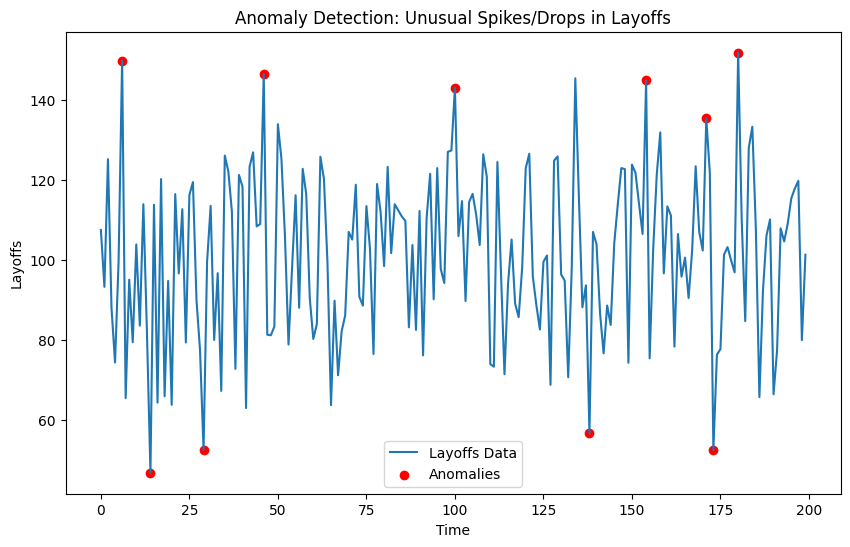

In [27]:
# Detect anomalies in layoffs data
def anomaly_detection(data):
    model = IsolationForest(contamination=0.05)  # 5% contamination for anomalies
    anomalies = model.fit_predict(data.reshape(-1, 1))

    plt.figure(figsize=(10, 6))
    plt.plot(data, label='Layoffs Data')
    plt.scatter(np.where(anomalies == -1), data[anomalies == -1], color='r', label='Anomalies')
    plt.title('Anomaly Detection: Unusual Spikes/Drops in Layoffs')
    plt.xlabel('Time')
    plt.ylabel('Layoffs')
    plt.legend()
    plt.show()

    return anomalies

# Example usage
if __name__ == "__main__":
    data = np.random.normal(100, 20, 200)  # Example data
    anomaly_detection(data)